In [1]:
from utils import *

In [2]:
from scipy.stats import pearsonr
import seaborn as sns
from IPython.display import Markdown

change the following `global_p` and rerun file

In [3]:
global_p = 0.15

In [4]:
bac = pd.read_excel("data/bac_phylum_fixed.xlsx", sheet_name=None)

In [5]:
bac['m1_rep1'].keys()

Index(['Phylum', 'd0con', 'd7con', 'd15con', 'd7ab', 'd15dss_ab', 'd7dss',
       'd15ab_dss', 'd15dss_h2o', 'd15ab_h2o', 'd7dab', 'd15dab_h2o'],
      dtype='object')

In [6]:
points_bac = ['d0con', 'd7con', 'd7dss', 'd7ab', 'd7dab', 'd15con', 'd15dss_ab', 'd15ab_dss', 'd15dss_h2o', 'd15ab_h2o', 'd15dab_h2o']

In [7]:
phylum_list = np.array(bac['m1_rep1']['Phylum'])

In [8]:
points_mb = ['0_con', '7_con', '7_dss', '7_ab', '7_dab', '15_con', '15_dss_ab', '15_ab_dss', '15_dss_h2o', '15_ab_h2o', '15_dab_h2o']

#### m1

In [9]:
! mkdir -p generated/pointcorr/{1 - global_p}/m1

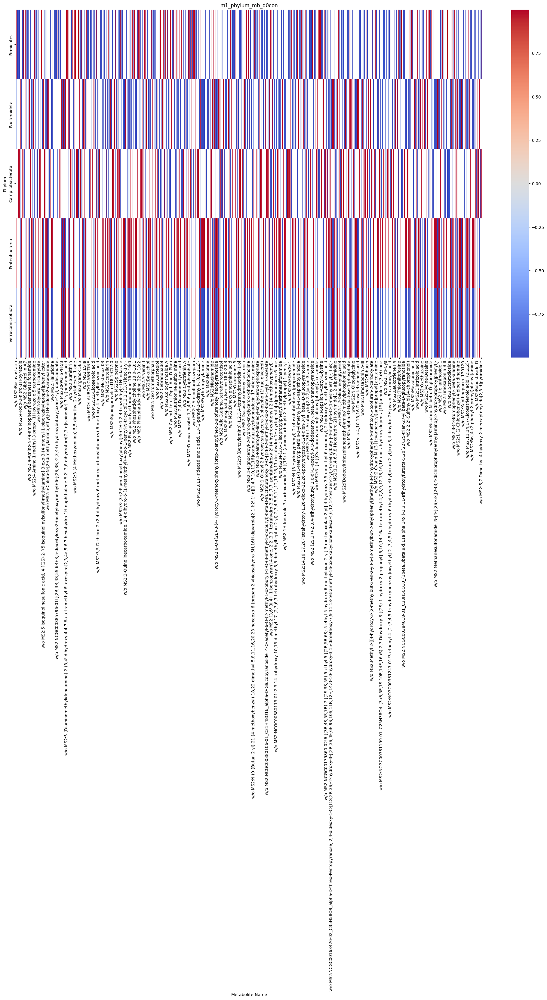

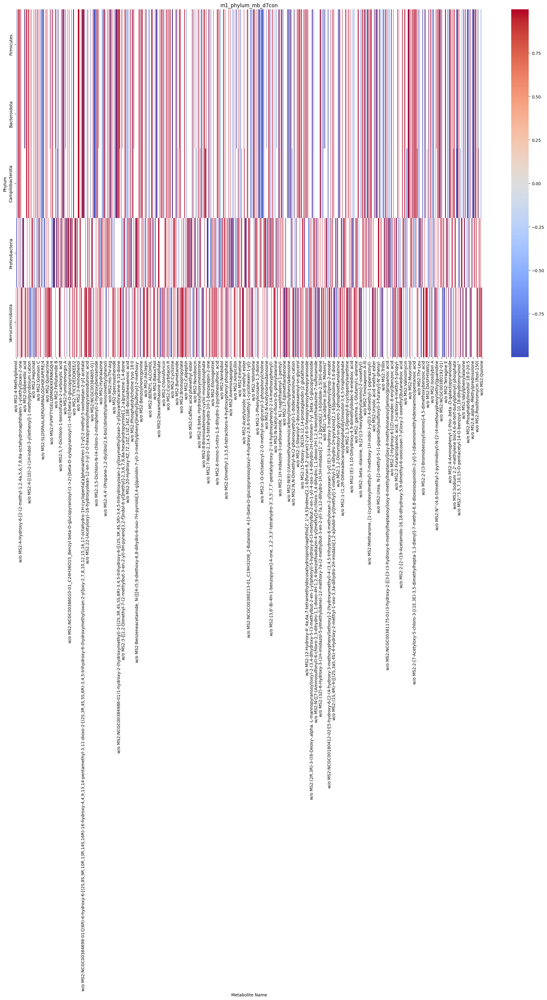

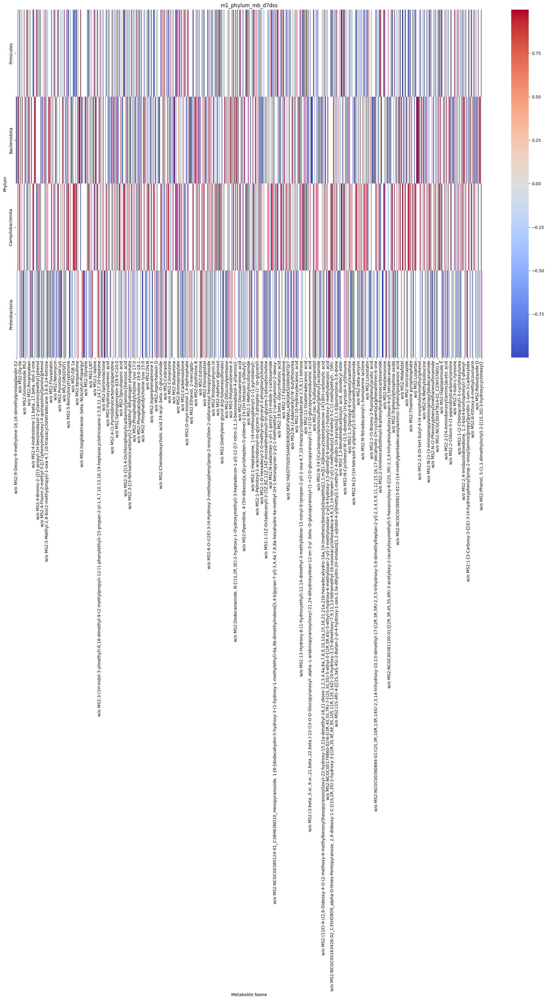

can't plot d7ab


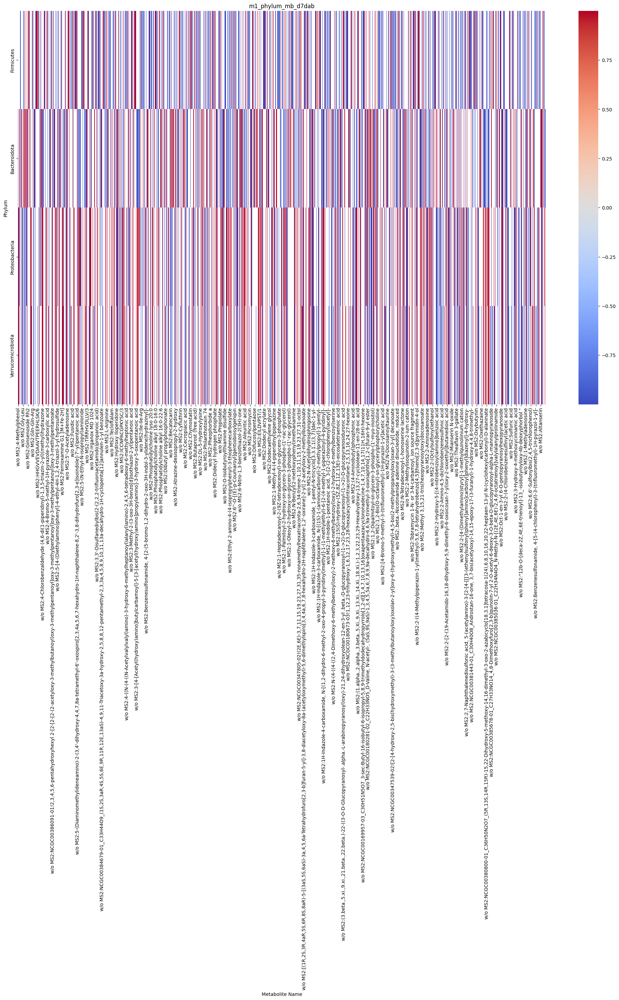

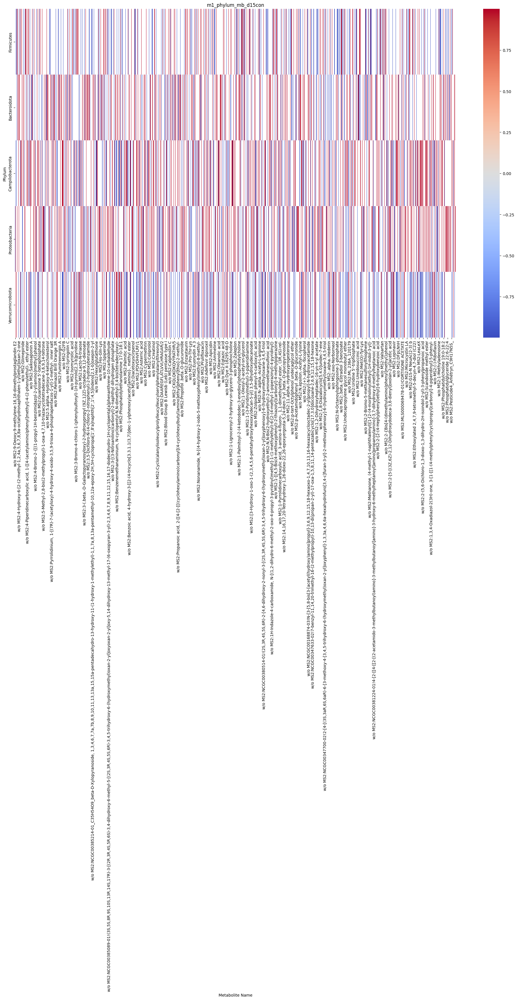

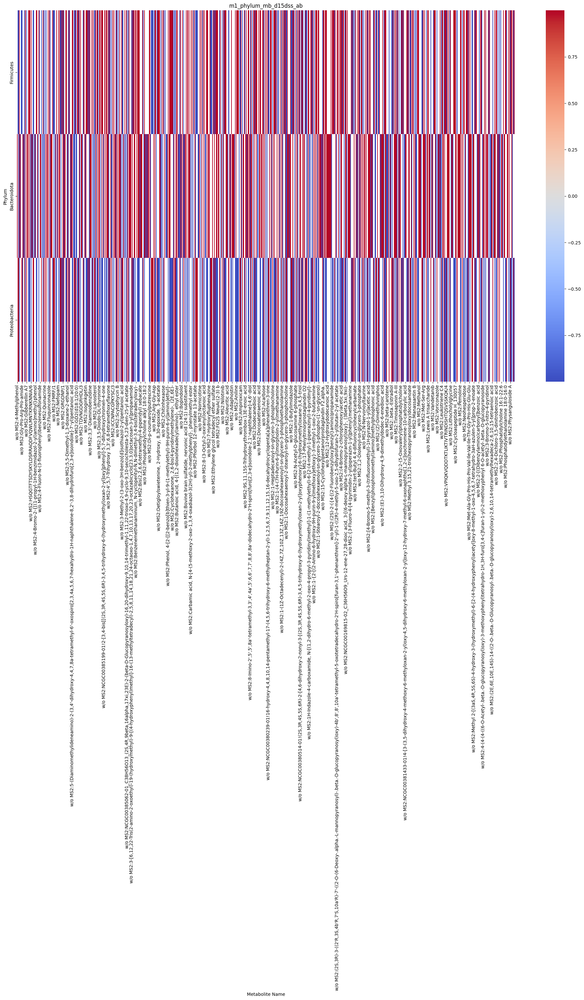

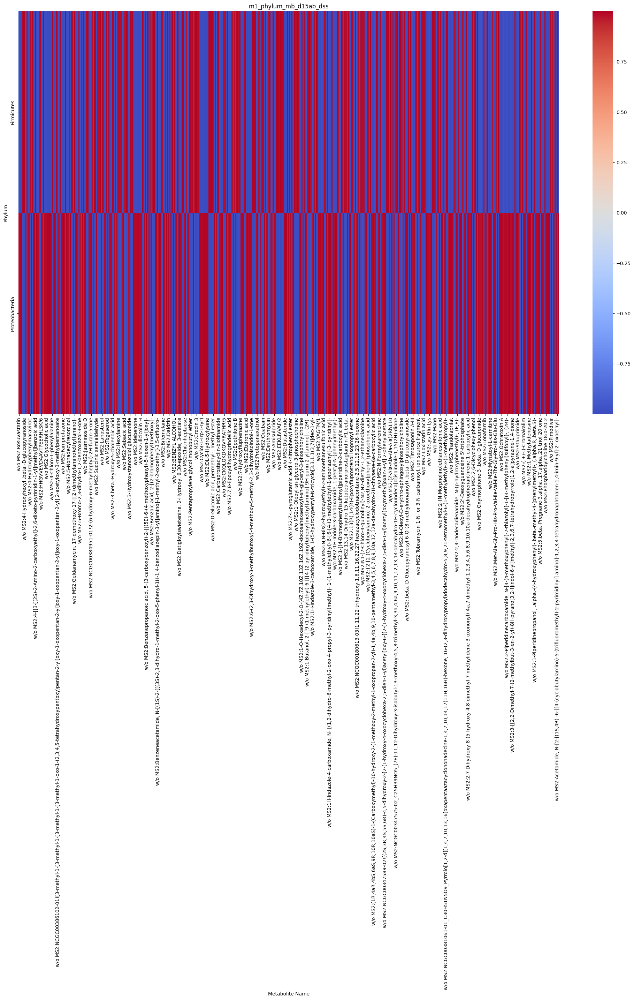

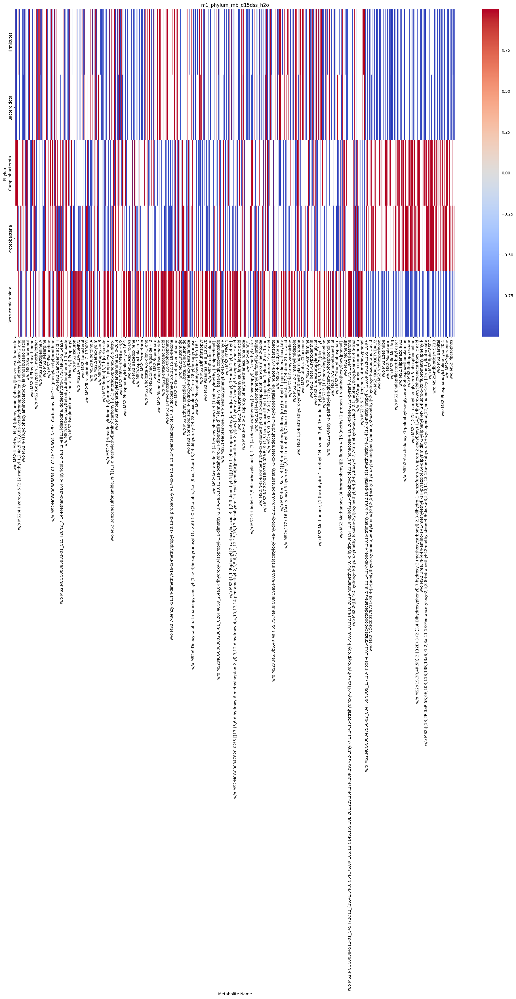

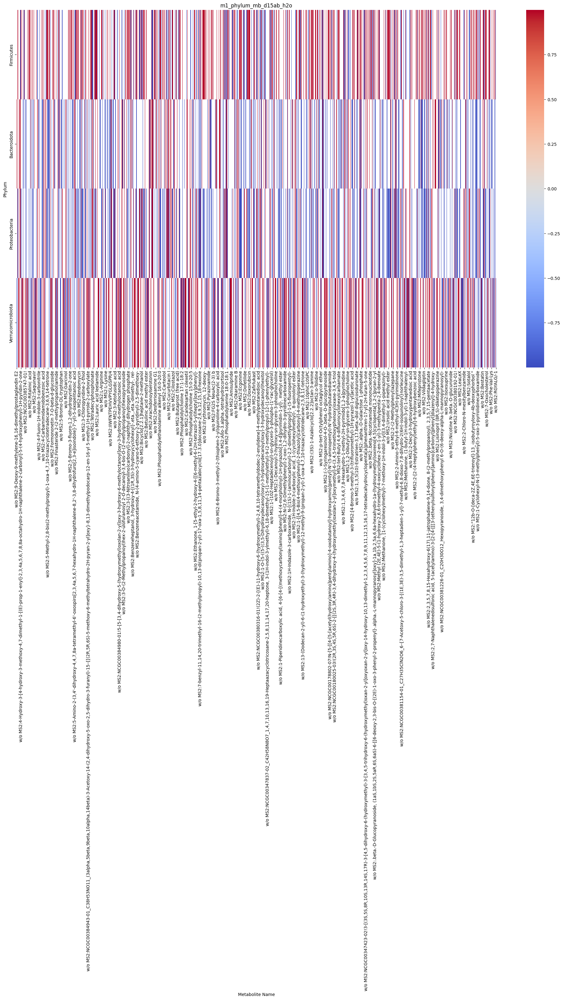

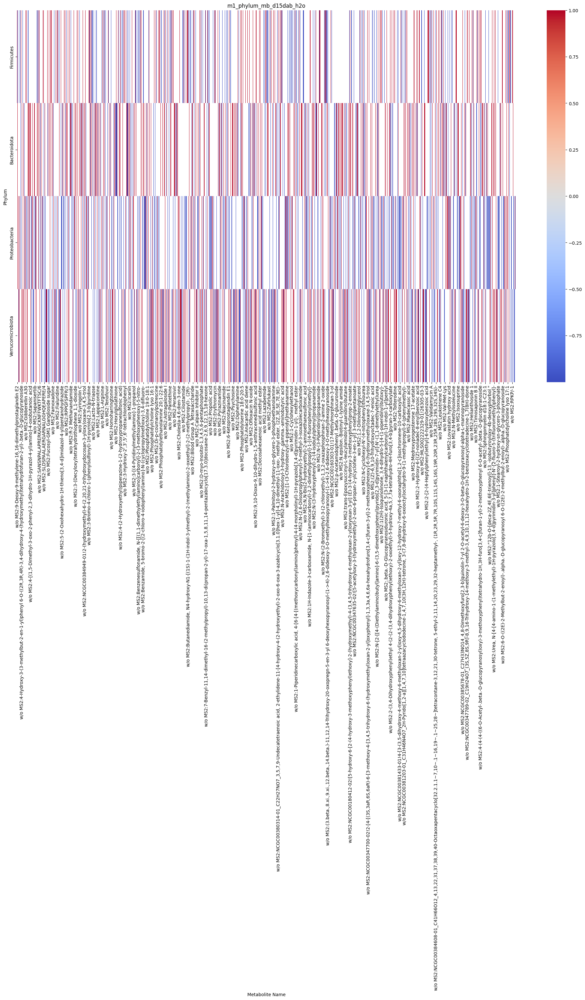

In [10]:
mb_m1 = list(pd.read_hdf('generated/a_cecal_mouse_1.hdf5', 'cvfiltered')['Metabolite Name'])
for i, _ in enumerate(points_bac):
    mb_rep1 = pd.read_hdf('generated/a_cecal_mouse_1.hdf5', 'rep_0')[['Metabolite Name', points_mb[i]]]
    mb_rep2 = pd.read_hdf('generated/a_cecal_mouse_1.hdf5', 'rep_1')[['Metabolite Name', points_mb[i]]]
    mb_rep3 = pd.read_hdf('generated/a_cecal_mouse_1.hdf5', 'rep_2')[['Metabolite Name', points_mb[i]]]

    mb_rep1 = mb_rep1.rename(columns={points_mb[i] : 'rep1'})
    mb_rep2 = mb_rep2.rename(columns={points_mb[i] : 'rep2'})
    mb_rep3 = mb_rep3.rename(columns={points_mb[i] : 'rep3'})

    merged_mb = mb_rep1.merge(mb_rep2, how='inner', on='Metabolite Name')
    merged_mb = merged_mb.merge(mb_rep3, how='inner', on='Metabolite Name')

    merged_mb = merged_mb.set_index('Metabolite Name')
    merged_mb = merged_mb[['rep1', 'rep2', 'rep3']]


    bac_rep1 = bac['m1_rep1'][['Phylum', points_bac[i]]]
    bac_rep2 = bac['m1_rep2'][['Phylum', points_bac[i]]]
    bac_rep3 = bac['m1_rep3'][['Phylum', points_bac[i]]]

    bac_rep1 = bac_rep1.rename(columns={points_bac[i] : 'rep1'})
    bac_rep2 = bac_rep2.rename(columns={points_bac[i] : 'rep2'})
    bac_rep3 = bac_rep3.rename(columns={points_bac[i] : 'rep3'})

    merged_bac = bac_rep1.merge(bac_rep2, how='inner', on='Phylum')
    merged_bac = merged_bac.merge(bac_rep3, how='inner', on='Phylum')

    merged_bac = merged_bac.set_index('Phylum')
    merged_bac = merged_bac[['rep1', 'rep2', 'rep3']]

    mask1 = (merged_bac['rep1'] != 0)
    mask2 = (merged_bac['rep2'] != 0)
    mask3 = (merged_bac['rep3'] != 0)

    maskall3 = mask1 & mask2 & mask3
    maskall2 = (mask1 & mask2 & ~mask3) | (mask1 & ~mask2 & mask3) | (~mask1 & mask2 & mask3)

    merged_bac = merged_bac[maskall3 | maskall2]

    
    smatrix = np.load(f"generated/pointcorr/m1/raw/raw_S_phylum_{points_bac[i]}.npy")
    pmatrix = np.load(f"generated/pointcorr/m1/raw/raw_P_phylum_{points_bac[i]}.npy")

    smatrix_sig = smatrix.copy()
    
    maskpm = pmatrix > global_p      #    pearson p
    smatrix_sig[maskpm] = 0
    corr_df_sig = pd.DataFrame(smatrix_sig, columns=merged_mb.index, index=merged_bac.index)
    corr_df_sig = corr_df_sig[mb_m1]
    corr_df_sig = corr_df_sig.fillna(0)
    corr_df_sig = corr_df_sig.loc[(corr_df_sig != 0).any(axis=1)]
    corr_df_sig = corr_df_sig.loc[:, (corr_df_sig != 0).any(axis=0)]
    corr_df_sig[corr_df_sig == 0] = np.nan
    # print(corr_df_sig.shape)

    corr_df_sig.to_csv(f"generated/pointcorr/{1 - global_p}/m1/phylum_{points_bac[i]}.csv")
    
    pyplot.rcParams['figure.figsize'] = (25, 15)
    try:
        sns.heatmap(corr_df_sig, cmap='coolwarm')
        pyplot.title(f'm1_phylum_mb_{points_bac[i]}')
        pyplot.show()
    except:
        print('can\'t plot', points_bac[i])
        pyplot.cla()

#### m2

In [11]:
! mkdir -p generated/pointcorr/{1 - global_p}/m2

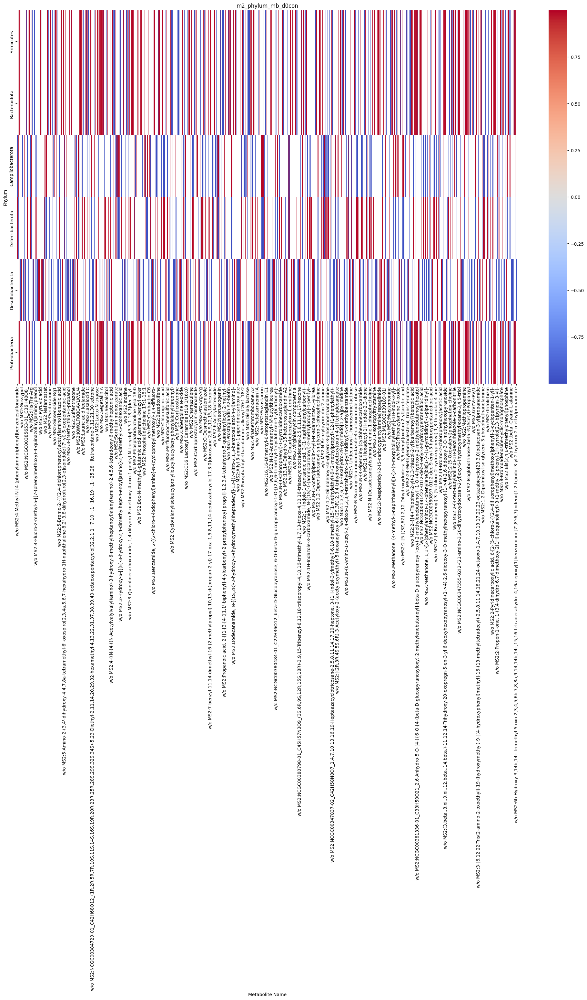

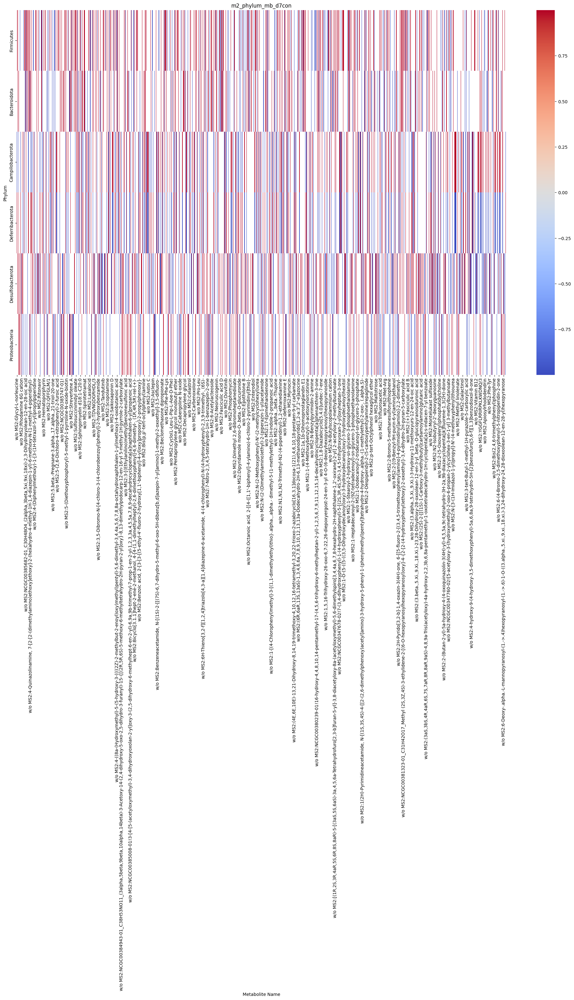

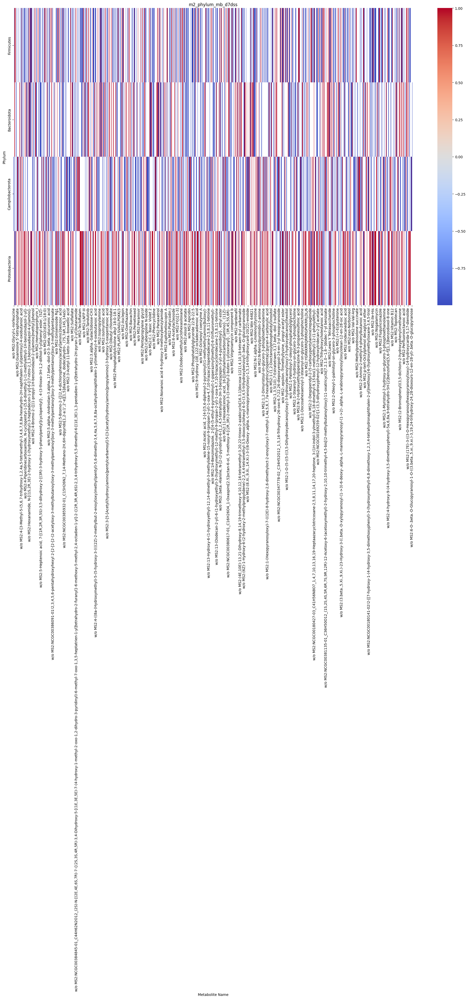

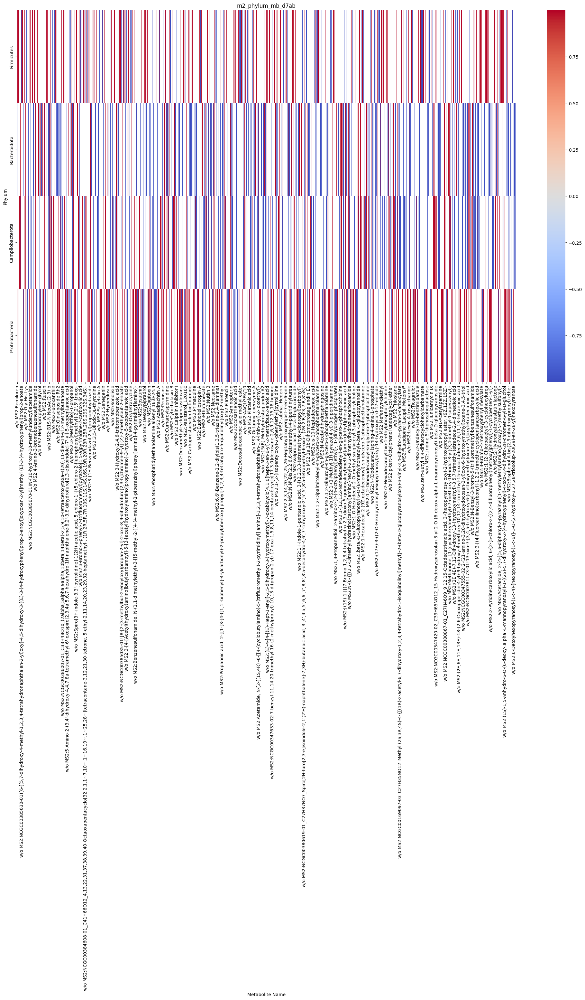

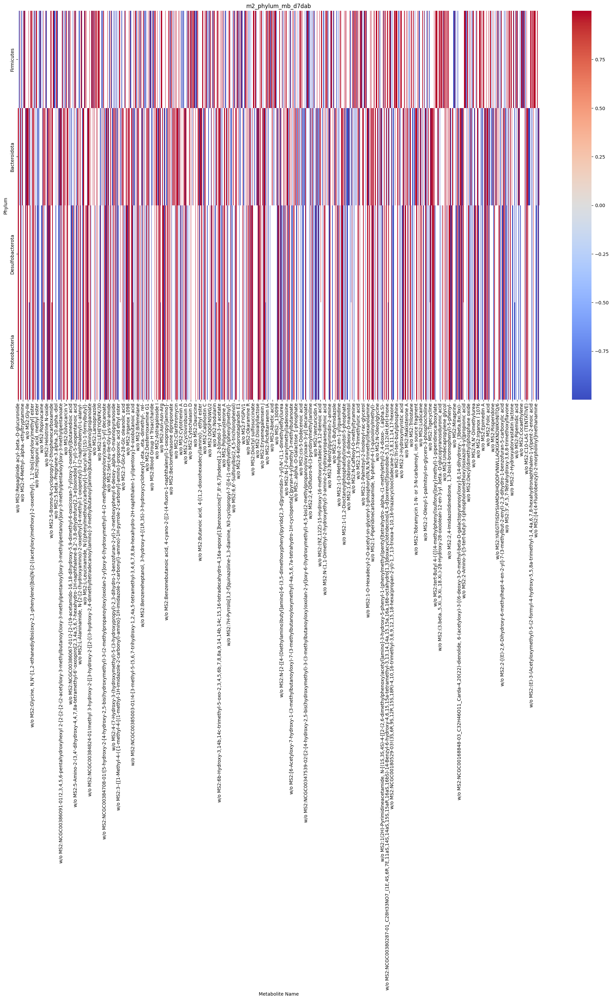

...

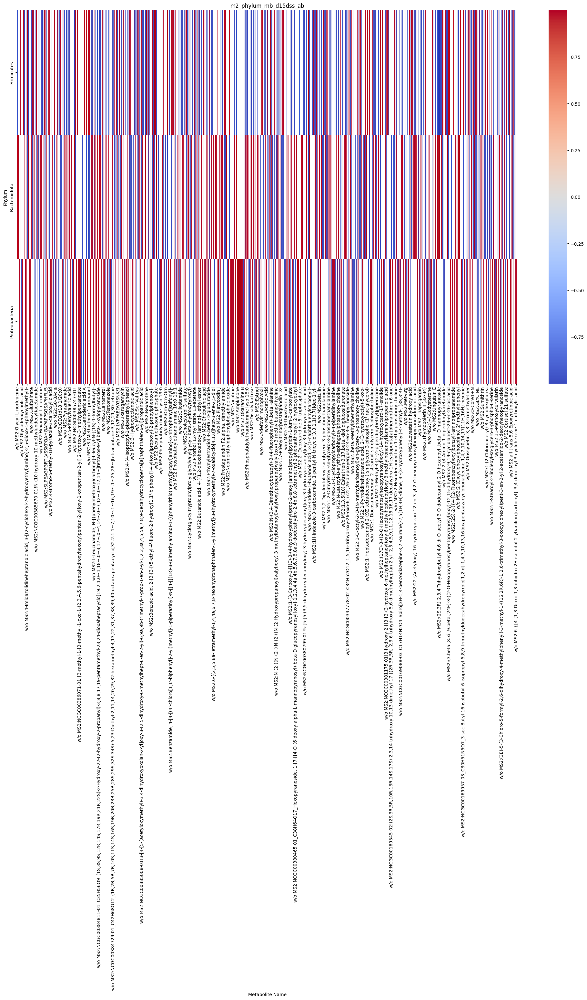

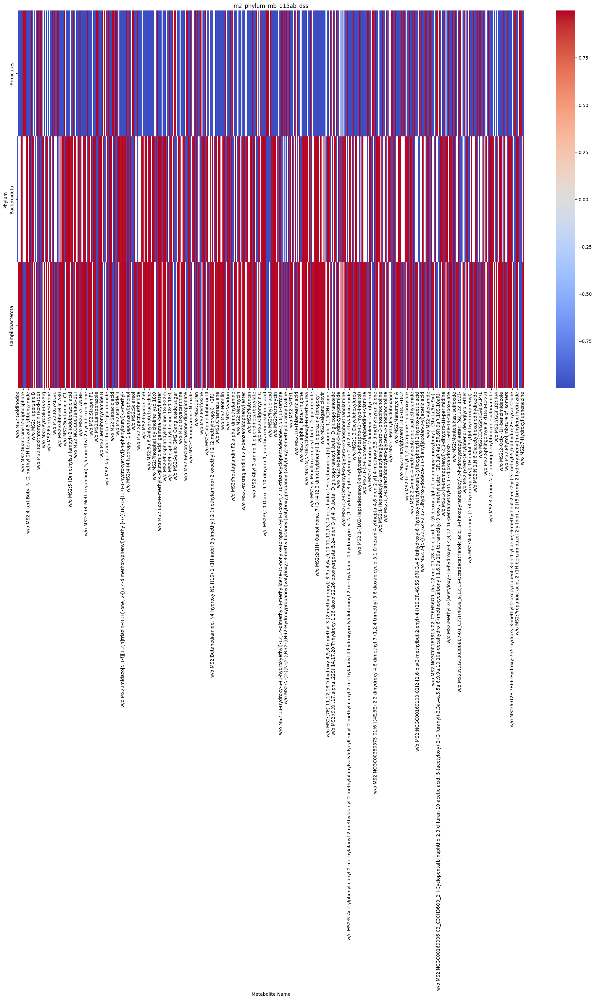

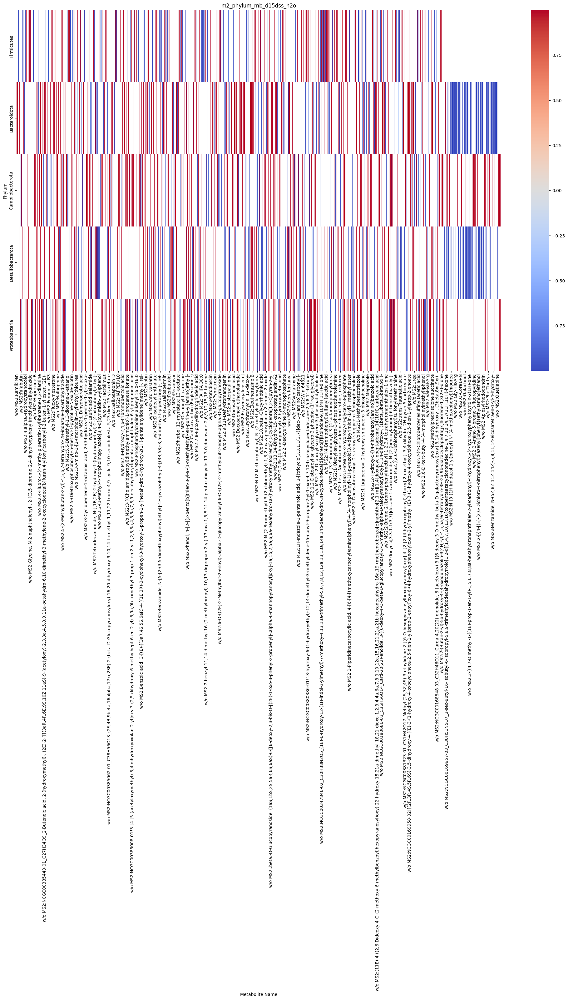

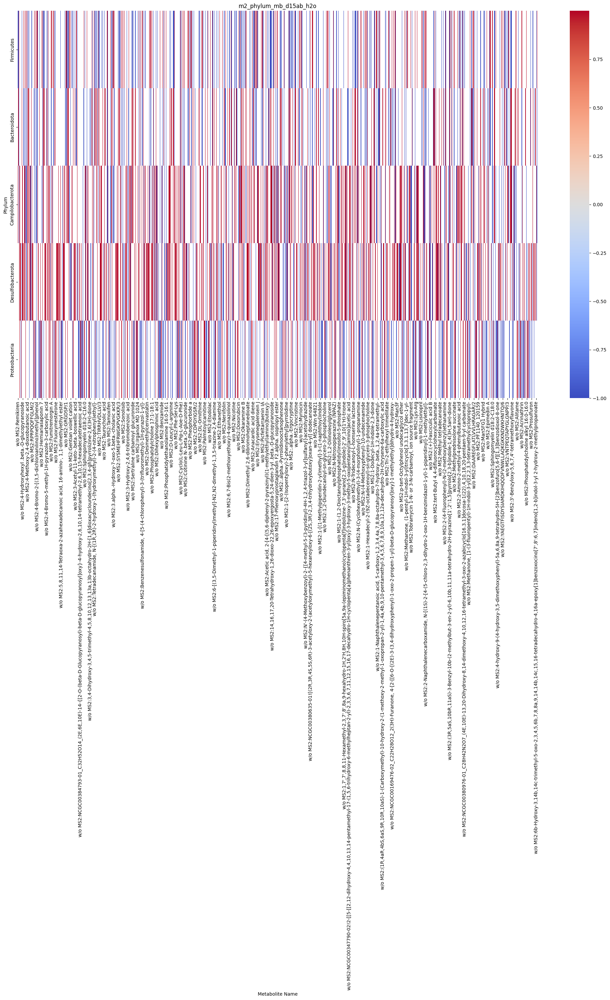

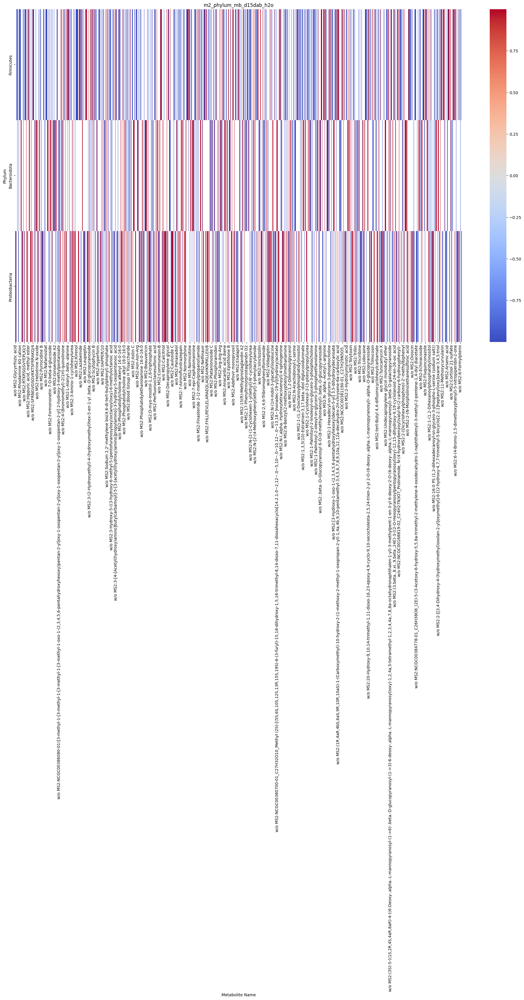

In [12]:
mb_m2 = list(pd.read_hdf('generated/a_cecal_mouse_2.hdf5', 'cvfiltered')['Metabolite Name'])
for i, _ in enumerate(points_bac):
    mb_rep1 = pd.read_hdf('generated/a_cecal_mouse_2.hdf5', 'rep_0')[['Metabolite Name', points_mb[i]]]
    mb_rep2 = pd.read_hdf('generated/a_cecal_mouse_2.hdf5', 'rep_1')[['Metabolite Name', points_mb[i]]]
    mb_rep3 = pd.read_hdf('generated/a_cecal_mouse_2.hdf5', 'rep_2')[['Metabolite Name', points_mb[i]]]

    mb_rep1 = mb_rep1.rename(columns={points_mb[i] : 'rep1'})
    mb_rep2 = mb_rep2.rename(columns={points_mb[i] : 'rep2'})
    mb_rep3 = mb_rep3.rename(columns={points_mb[i] : 'rep3'})

    merged_mb = mb_rep1.merge(mb_rep2, how='inner', on='Metabolite Name')
    merged_mb = merged_mb.merge(mb_rep3, how='inner', on='Metabolite Name')

    merged_mb = merged_mb.set_index('Metabolite Name')
    merged_mb = merged_mb[['rep1', 'rep2', 'rep3']]


    bac_rep1 = bac['m2_rep1'][['Phylum', points_bac[i]]]
    bac_rep2 = bac['m2_rep2'][['Phylum', points_bac[i]]]
    bac_rep3 = bac['m2_rep3'][['Phylum', points_bac[i]]]

    bac_rep1 = bac_rep1.rename(columns={points_bac[i] : 'rep1'})
    bac_rep2 = bac_rep2.rename(columns={points_bac[i] : 'rep2'})
    bac_rep3 = bac_rep3.rename(columns={points_bac[i] : 'rep3'})

    merged_bac = bac_rep1.merge(bac_rep2, how='inner', on='Phylum')
    merged_bac = merged_bac.merge(bac_rep3, how='inner', on='Phylum')

    merged_bac = merged_bac.set_index('Phylum')
    merged_bac = merged_bac[['rep1', 'rep2', 'rep3']]

    mask1 = (merged_bac['rep1'] != 0)
    mask2 = (merged_bac['rep2'] != 0)
    mask3 = (merged_bac['rep3'] != 0)

    maskall3 = mask1 & mask2 & mask3
    maskall2 = (mask1 & mask2 & ~mask3) | (mask1 & ~mask2 & mask3) | (~mask1 & mask2 & mask3)

    merged_bac = merged_bac[maskall3 | maskall2]

    smatrix = np.load(f"generated/pointcorr/m2/raw/raw_S_phylum_{points_bac[i]}.npy")
    pmatrix = np.load(f"generated/pointcorr/m2/raw/raw_P_phylum_{points_bac[i]}.npy")

    smatrix_sig = smatrix.copy()
    
    maskpm = pmatrix > global_p      #    pearson p
    smatrix_sig[maskpm] = 0
    corr_df_sig = pd.DataFrame(smatrix_sig, columns=merged_mb.index, index=merged_bac.index)
    corr_df_sig = corr_df_sig[mb_m2]
    corr_df_sig = corr_df_sig.fillna(0)
    corr_df_sig = corr_df_sig.loc[(corr_df_sig != 0).any(axis=1)]
    corr_df_sig = corr_df_sig.loc[:, (corr_df_sig != 0).any(axis=0)]
    corr_df_sig[corr_df_sig == 0] = np.nan
    # print(corr_df_sig.shape)

    corr_df_sig.to_csv(f"generated/pointcorr/{1- global_p}/m2/phylum_{points_bac[i]}.csv")
    
    pyplot.rcParams['figure.figsize'] = (25, 15)
    try:
        sns.heatmap(corr_df_sig, cmap='coolwarm')
        pyplot.title(f'm2_phylum_mb_{points_bac[i]}')
        pyplot.show()
    except:
        print('can\'t plot', points_bac[i])
        pyplot.cla()